In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as matplotlib
import matplotlib.pyplot as plt

## Datos de satisfacción de pasajeros de aerolínea
#### https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction/download

#### Este dataset contiene una encuesta de satisfacción de pasajeros de una aerolínea ¿Qué factores están altamente correlacionados con un pasajero satisfecho o no satisfecho? ¿Se puede predecir la satisfacción del pasajero?

## Descripción de atributos
Los 24 atributos o columnas presentes en el dataset son:
- **id**: número identificatorio del registro.
- **Gender**: sexo del pasajero (Female, Male).
- **Customer Type**: el tipo de cliente (Loyal customer, disloyal customer).
- **Age**: la edad del pasajero.
- **Type of Travel**: motivo del viaje (Personal Travel, Business Travel).
- **Class**: clase en la que viaja (Business, Eco, Eco Plus).
- **Flight distance**: distancia recorrida en el vuelo, en kilómetros.
- **Inflight wifi service**: nivel de satisfacción con el servicio de WiFi a bordo (0:NotApplicable;1-5).
- **Departure/Arrival time convenient**: nivel de satisfacción con los horarios de salida/llegada del vuelo.
- **Ease of Online booking**: nivel de satisfacción con la experiencia de compra/reserva online.
- **Gate location**: nivel de satisfacción con la ubicación de la puerta de abordaje.
- **Food and drink**: nivel de satisfacción con la comida y la bebida a bordo.
- **Online boarding**: nivel de satisfacción con el servicio de check-in y abordaje online.
- **Seat comfort**: nivel de satisfacción con el confort de la butaca en el vuelo.
- **Inflight entertainment**: nivel de satisfacción con el entretenimiento a bordo.
- **On-board service**: nivel de satisfacción con el servicio recibido a bordo.
- **Leg room service**: nivel de satisfacción con el espacio para piernas de la butaca.
- **Baggage handling**: nivel de satisfacción con el manejo de las valijas por parte de la aerolínea/aeropuerto.
- **Check-in service**: nivel de satisfacción con el servicio presencial de check-in.
- **Inflight service**: nivel de satisfacción con el servicio recibido mientras el avión estaba en el aire.
- **Cleanliness**: nivel de satisfacción con la limpieza.
- **Departure Delay in Minutes**: minutos de demora en el despegue.
- **Arrival Delay in Minutes**: minutos de atraso en la llegada/aterrizaje.
- **Satisfaction**: nivel de satisfacción general con la aerolínea - clase/target (Satisfaction, neutral or dissatisfaction)

## Data wrangling

In [2]:
train = pd.read_csv('data/train.csv')
test = pd.read_csv('data/test.csv')
train.shape, test.shape

((103904, 25), (25976, 25))

In [3]:
data = pd.concat([train, test], ignore_index=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         129880 non-null  int64  
 1   id                                 129880 non-null  int64  
 2   Gender                             129880 non-null  object 
 3   Customer Type                      129880 non-null  object 
 4   Age                                129880 non-null  int64  
 5   Type of Travel                     129880 non-null  object 
 6   Class                              129880 non-null  object 
 7   Flight Distance                    129880 non-null  int64  
 8   Inflight wifi service              129880 non-null  int64  
 9   Departure/Arrival time convenient  129880 non-null  int64  
 10  Ease of Online booking             129880 non-null  int64  
 11  Gate location                      1298

In [4]:
data.head()

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


## AUTO EDA

In [5]:
from pandas_profiling import ProfileReport
prof = ProfileReport(data)
prof.to_file(output_file='eda_output.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

C:\Users\Maximiliano\anaconda3\lib\site-packages\scipy\stats\stats.py:4812: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
prof.to_notebook_iframe()

## EDA

In [7]:
data.duplicated().sum()

0

In [8]:
data.isna().sum()

Unnamed: 0                             0
id                                     0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
satisfaction    

In [9]:
print("Arrival Delay in Minutes NA:", data['Arrival Delay in Minutes'].isna().sum() / data.shape[0] * 100, "%")

Arrival Delay in Minutes NA: 0.3025870033877425 %


In [10]:
data.describe(percentiles=[0.05, 0.25, 0.50, 0.75, 0.95]).T

,count,mean,std,min,5%,25%,50%,75%,95%,max
Unnamed: 0,129880.0,44158.700000,31207.377062,0.0,3246.95,16234.75,38963.5,71433.25,97409.05,103903.0
id,129880.0,64940.500000,37493.270818,1.0,6494.95,32470.75,64940.5,97410.25,123386.05,129880.0
Age,129880.0,39.427957,15.119360,7.0,15.00,27.00,40.0,51.00,64.00,85.0
Flight Distance,129880.0,1190.316392,997.452477,31.0,176.95,414.00,844.0,1744.00,3380.00,4983.0
Inflight wifi service,129880.0,2.728696,1.329340,0.0,1.00,2.00,3.0,4.00,5.00,5.0
Departure/Arrival time convenient,129880.0,3.057599,1.526741,0.0,0.00,2.00,3.0,4.00,5.00,5.0
Ease of Online booking,129880.0,2.756876,1.401740,0.0,1.00,2.00,3.0,4.00,5.00,5.0
Gate location,129880.0,2.976925,1.278520,0.0,1.00,2.00,3.0,4.00,5.00,5.0
Food and drink,129880.0,3.204774,1.329933,0.0,1.00,2.00,3.0,4.00,5.00,5.0
Online boarding,129880.0,3.252633,1.350719,0.0,1.00,2.00,3.0,4.00,5.00,5.0


In [11]:
data['Gender'].value_counts() / data.shape[0] * 100

Female    50.738374
Male      49.261626
Name: Gender, dtype: float64

In [12]:
data['Customer Type'].value_counts() / data.shape[0] * 100

Loyal Customer       81.690791
disloyal Customer    18.309209
Name: Customer Type, dtype: float64

In [13]:
data['Type of Travel'].value_counts() / data.shape[0] * 100

Business travel    69.058362
Personal Travel    30.941638
Name: Type of Travel, dtype: float64

In [14]:
data['Class'].value_counts() / data.shape[0] * 100

Business    47.859563
Eco         44.894518
Eco Plus     7.245919
Name: Class, dtype: float64

In [15]:
data['satisfaction'].value_counts() / data.shape[0] * 100

neutral or dissatisfied    56.553742
satisfied                  43.446258
Name: satisfaction, dtype: float64

###


In [16]:
# plot common info
color_scheme = {'lightgreen', 'lightsalmon'}

data_satisfied = data[data['satisfaction'] == 'satisfied']
data_non_satisfied = data[data['satisfaction'] == 'neutral or dissatisfied']

[]

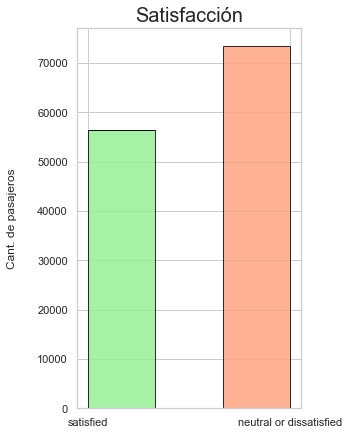

In [17]:
satisfied = data_satisfied['satisfaction']
non_satisfied = data_non_satisfied['satisfaction']

sns.set(rc = {'figure.figsize':(4, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, bins = 3, color = color_scheme, alpha = 0.8, edgecolor = 'black')
plt.ylabel('Cant. de pasajeros', labelpad = 20)
plt.title('Satisfacción', fontdict = {'fontsize': '20'})
plt.plot()

[]

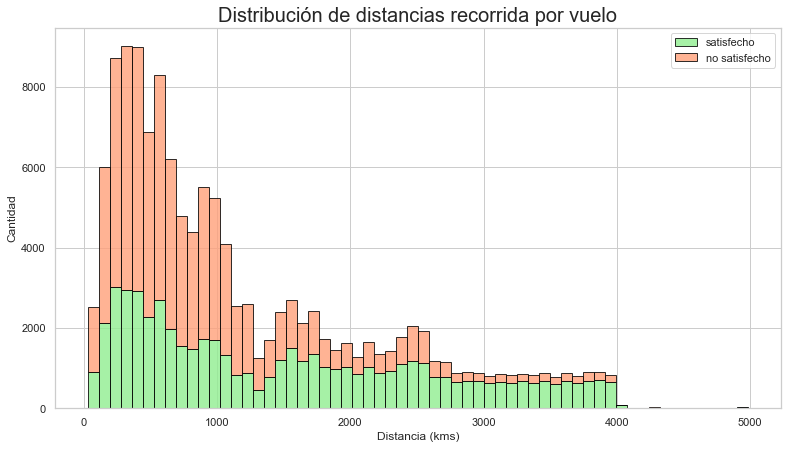

In [18]:
satisfied = data_satisfied['Flight Distance']
non_satisfied = data_non_satisfied['Flight Distance']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, bins = 60, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Distancia (kms)')
plt.ylabel('Cantidad')
plt.title('Distribución de distancias recorrida por vuelo', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

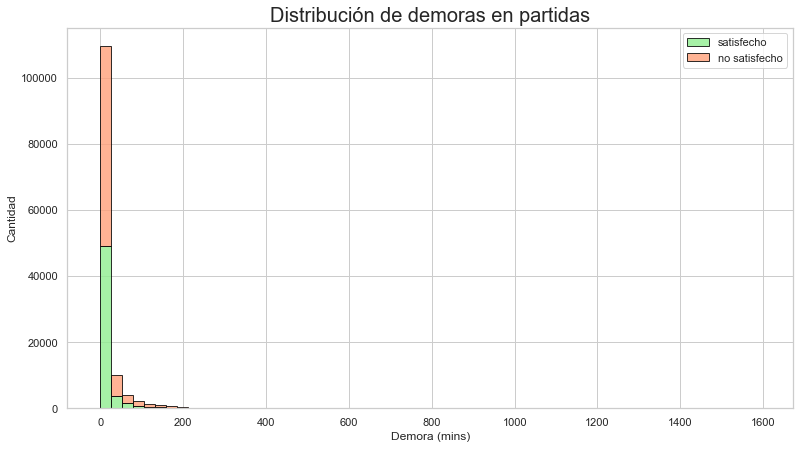

In [19]:
satisfied = data_satisfied['Departure Delay in Minutes']
non_satisfied = data_non_satisfied['Departure Delay in Minutes']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, bins = 60, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Demora (mins)')
plt.ylabel('Cantidad')
plt.title('Distribución de demoras en partidas', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

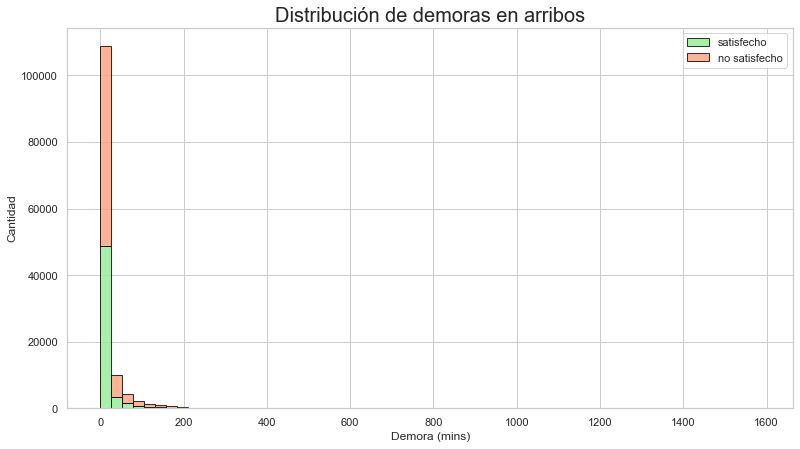

In [20]:
satisfied = data_satisfied['Arrival Delay in Minutes']
non_satisfied = data_non_satisfied['Arrival Delay in Minutes']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, bins = 60, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Demora (mins)')
plt.ylabel('Cantidad')
plt.title('Distribución de demoras en arribos', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

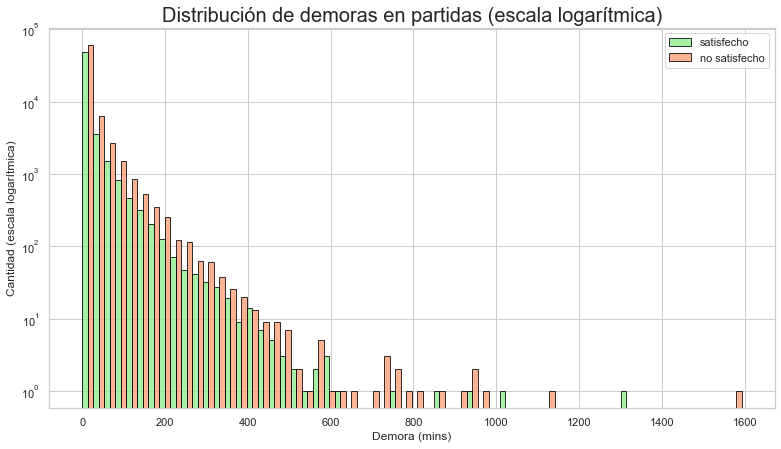

In [21]:
satisfied = data_satisfied['Departure Delay in Minutes']
non_satisfied = data_non_satisfied['Departure Delay in Minutes']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], rwidth = 1, bins = 60, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'], log = True)
plt.xlabel('Demora (mins)')
plt.ylabel('Cantidad (escala logarítmica)')
plt.title('Distribución de demoras en partidas (escala logarítmica)', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

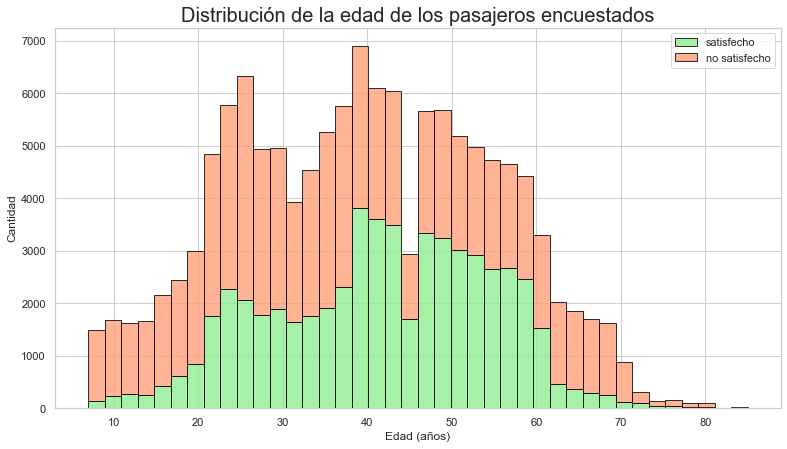

In [22]:
satisfied = data_satisfied['Age']
non_satisfied = data_non_satisfied['Age']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, bins = 40, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Edad (años)')
plt.ylabel('Cantidad')
plt.title('Distribución de la edad de los pasajeros encuestados', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

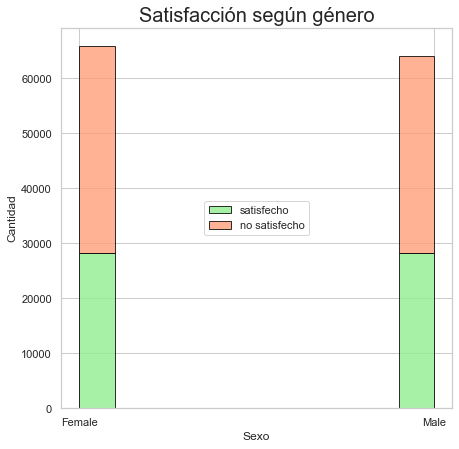

In [23]:
satisfied = data_satisfied['Gender']
non_satisfied = data_non_satisfied['Gender']

sns.set(rc = {'figure.figsize':(7, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, rwidth = 5.0, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Sexo')
plt.ylabel('Cantidad')
plt.title('Satisfacción según género', fontdict = {'fontsize': '20'})
plt.legend(loc = 'center')
plt.plot()

[]

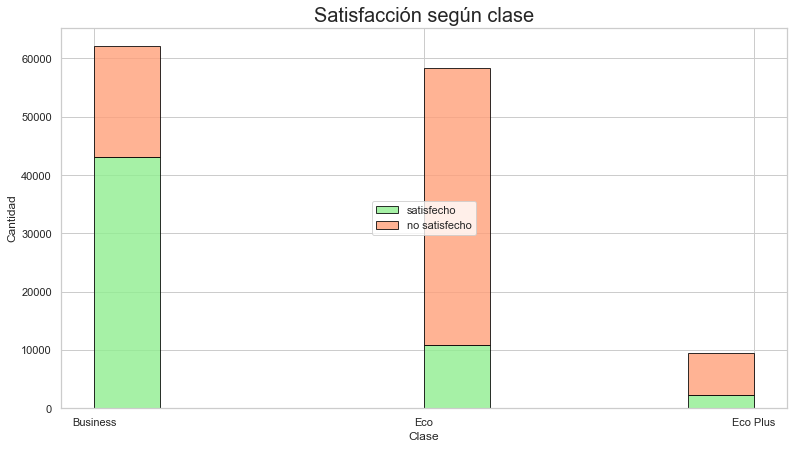

In [24]:
satisfied = data_satisfied['Class']
non_satisfied = data_non_satisfied['Class']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Clase')
plt.ylabel('Cantidad')
plt.title('Satisfacción según clase', fontdict = {'fontsize': '20'})
plt.legend(loc = 'center')
plt.plot()

[]

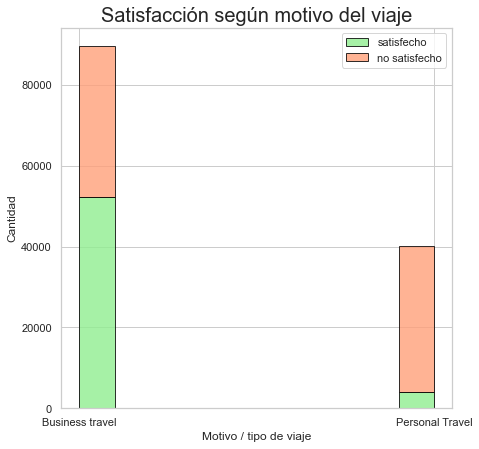

In [25]:
satisfied = data_satisfied['Type of Travel']
non_satisfied = data_non_satisfied['Type of Travel']

sns.set(rc = {'figure.figsize':(7, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, rwidth = 5.0, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Motivo / tipo de viaje')
plt.ylabel('Cantidad')
plt.title('Satisfacción según motivo del viaje', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

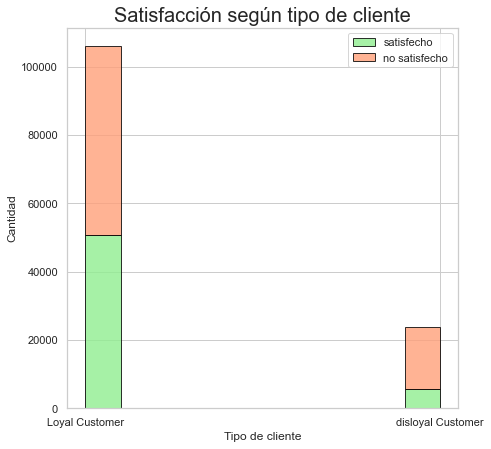

In [26]:
satisfied = data_satisfied['Customer Type']
non_satisfied = data_non_satisfied['Customer Type']

sns.set(rc = {'figure.figsize':(7, 7)}, style = "whitegrid")
plt.hist([satisfied, non_satisfied], stacked = True, rwidth = 5.0, color = color_scheme, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Tipo de cliente')
plt.ylabel('Cantidad')
plt.title('Satisfacción según tipo de cliente', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

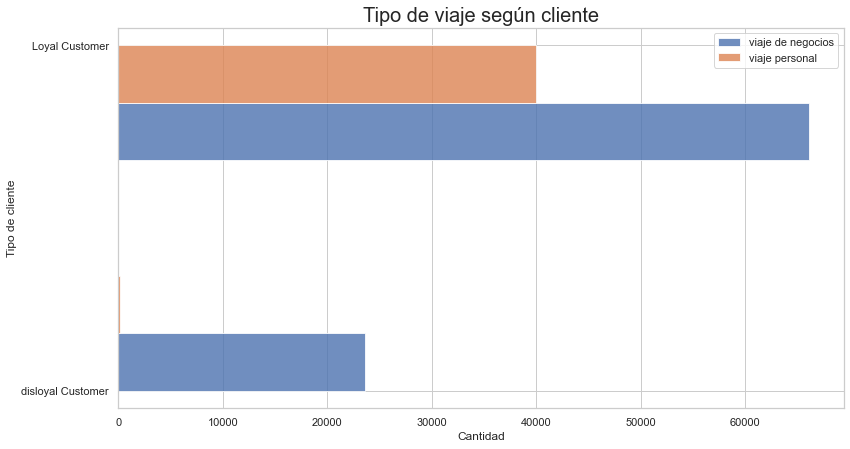

In [27]:
business = data[data['Type of Travel'] == 'Business travel']['Customer Type']
personal = data[data['Type of Travel'] == 'Personal Travel']['Customer Type']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([business, personal], rwidth = 5.0, bins = 3, alpha = 0.8, edgecolor = 'white', label = ['viaje de negocios', 'viaje personal'], orientation = 'horizontal')
plt.xlabel('Cantidad')
plt.ylabel('Tipo de cliente')
plt.title('Tipo de viaje según cliente', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

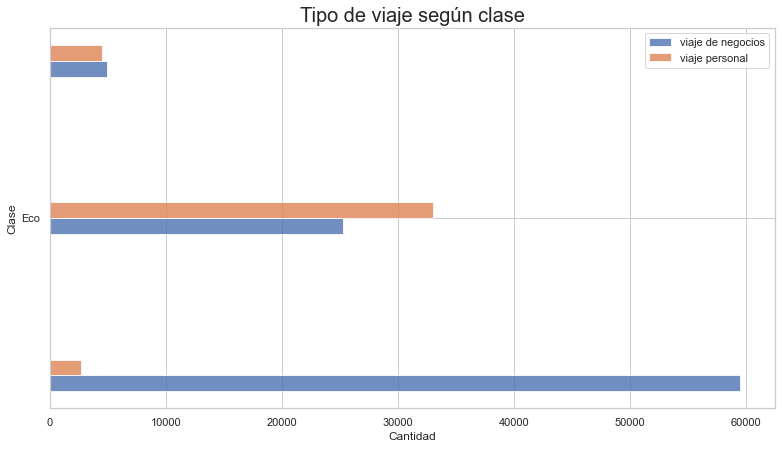

In [28]:
business = data[data['Type of Travel'] == 'Business travel']['Class']
personal = data[data['Type of Travel'] == 'Personal Travel']['Class']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.hist([business, personal], bins = 5, rwidth = 0.4, alpha = 0.8, edgecolor = 'white', label = ['viaje de negocios', 'viaje personal'], orientation = 'horizontal')
plt.xlabel('Cantidad')
plt.ylabel('Clase')
plt.title('Tipo de viaje según clase', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

[]

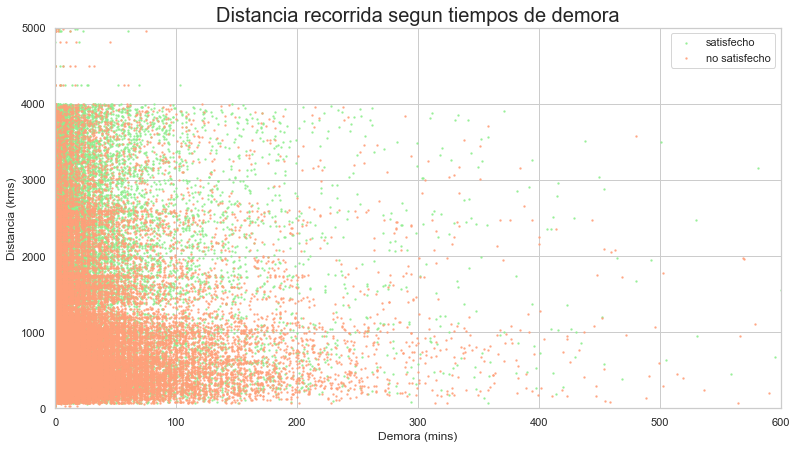

In [29]:
satisfied = data_satisfied[['Departure Delay in Minutes', 'Flight Distance']]
non_satisfied = data_non_satisfied[['Departure Delay in Minutes', 'Flight Distance']]

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
plt.scatter(satisfied['Departure Delay in Minutes'], satisfied['Flight Distance'], s = 2, c = 'lightgreen', alpha = 0.75, label = 'satisfecho')
plt.scatter(non_satisfied['Departure Delay in Minutes'], non_satisfied['Flight Distance'], s = 2, c = 'lightsalmon', alpha = 0.75, label = 'no satisfecho')

plt.xlabel('Demora (mins)')
plt.ylabel('Distancia (kms)')
plt.title('Distancia recorrida segun tiempos de demora', fontdict = {'fontsize': '20'})
plt.xlim(0, 600)
plt.ylim(0, 5000)
plt.legend()
plt.plot()

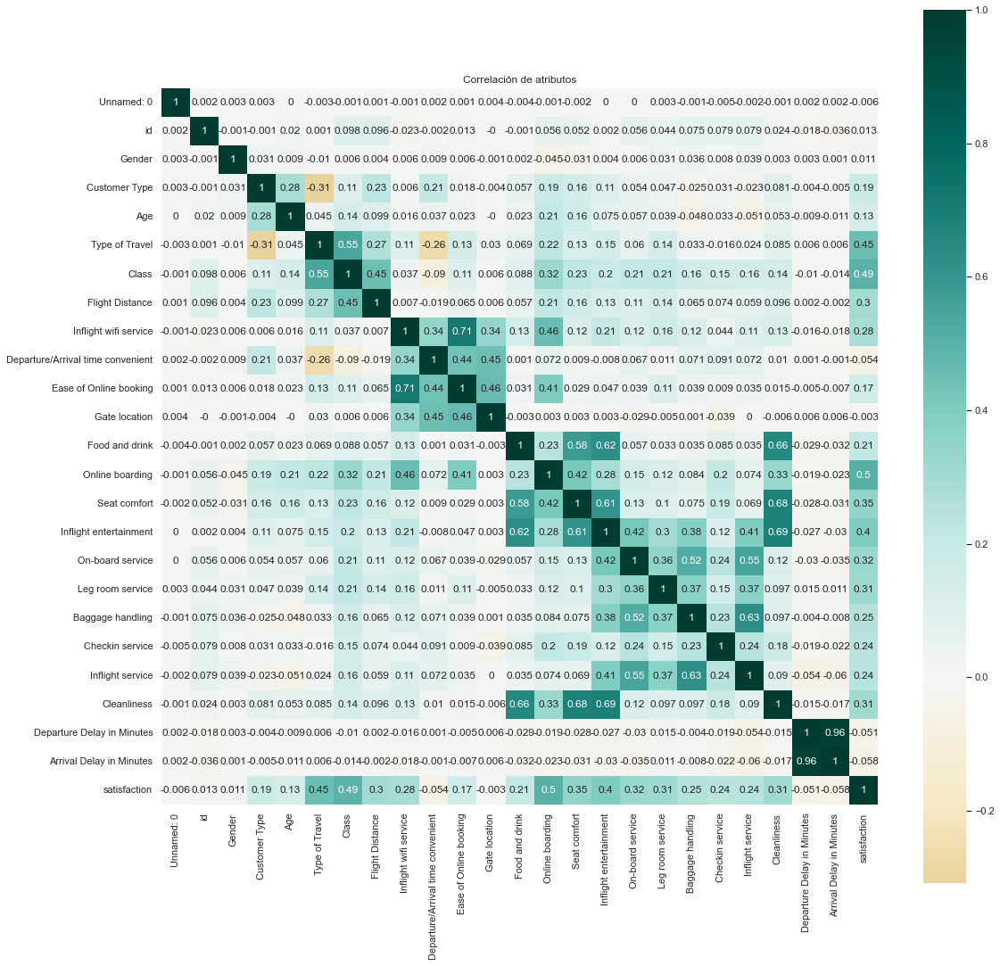

In [30]:
corr_temp_data = data.copy()
corr_temp_data['Gender'].replace({'Male': 1, 'Female': 0}, inplace = True)
corr_temp_data['Customer Type'].replace({'Loyal Customer': 1, 'disloyal Customer': 0}, inplace = True)
corr_temp_data['Type of Travel'].replace({'Business travel': 1, 'Personal Travel': 0}, inplace = True)
corr_temp_data['Class'].replace({'Business': 2, 'Eco Plus': 1, 'Eco':0}, inplace = True)
corr_temp_data['satisfaction'].replace({'satisfied': 1, 'neutral or dissatisfied': 0}, inplace = True)

plt.subplots(figsize=(18, 18))
sns_plot = sns.heatmap(corr_temp_data.corr(method = 'pearson').round(decimals = 3), annot = True, cmap="BrBG", center = 0.0, square = True)
sns_plot.set_title('Correlación de atributos')
sns_plot.get_figure().savefig("correlacion_pearson.png")

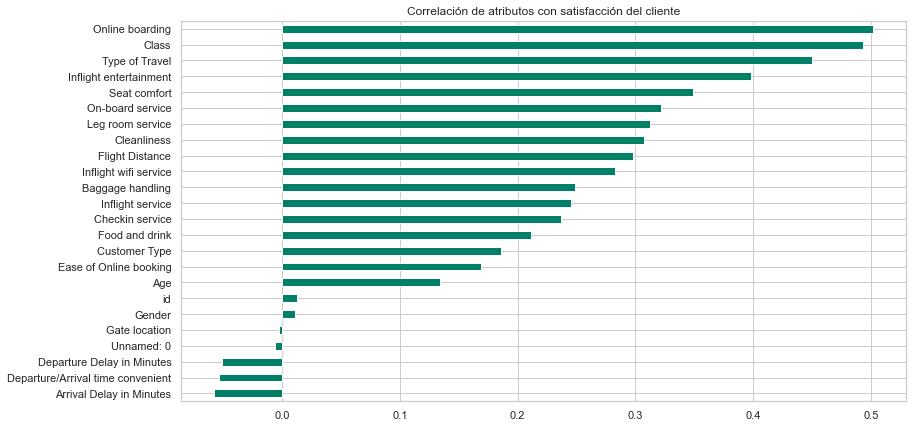

In [31]:
sns.set(rc={'figure.figsize':(13, 7)}, style = "whitegrid")
corr_temp_data.corr(method = 'pearson')['satisfaction'].drop(['satisfaction']).round(decimals = 3).sort_values().plot(kind = 'barh', grid = True, colormap = 'summer', title = 'Correlación de atributos con satisfacción del cliente')
del corr_temp_data

## Data Cleaning

In [32]:
data.drop(columns = ['Unnamed: 0','id'], inplace = True)

In [33]:
data['Arrival Delay in Minutes'].describe(percentiles=[0.05, 0.25, 0.50, 0.75, 0.95])

count    129487.000000
mean         15.091129
std          38.465650
min           0.000000
5%            0.000000
25%           0.000000
50%           0.000000
75%          13.000000
95%          78.000000
max        1584.000000
Name: Arrival Delay in Minutes, dtype: float64

In [34]:
delay_values = data['Arrival Delay in Minutes'].value_counts()
delay_values

0.0      72753
1.0       2747
2.0       2587
3.0       2442
4.0       2373
         ...  
604.0        1
457.0        1
459.0        1
502.0        1
333.0        1
Name: Arrival Delay in Minutes, Length: 472, dtype: int64

In [35]:
delay_values[delay_values.index > 60 * 12]

920.0     1
970.0     1
748.0     1
1115.0    1
1584.0    1
940.0     1
795.0     1
822.0     1
729.0     1
860.0     1
1280.0    1
924.0     1
1011.0    1
952.0     1
823.0     1
Name: Arrival Delay in Minutes, dtype: int64

In [36]:
data['Arrival Delay in Minutes'] = data['Arrival Delay in Minutes'][data['Arrival Delay in Minutes'] < 60 * 12]
data['Departure Delay in Minutes'] = data['Departure Delay in Minutes'][data['Departure Delay in Minutes'] < 60 * 12]

In [37]:
data['Arrival Delay in Minutes'].fillna(data['Arrival Delay in Minutes'].mean(), inplace = True)
data['Departure Delay in Minutes'].fillna(data['Departure Delay in Minutes'].mean(), inplace = True)

data['Arrival Delay in Minutes'] = data['Arrival Delay in Minutes'].astype('int64')
data['Departure Delay in Minutes'] = data['Departure Delay in Minutes'].astype('int64')

In [38]:
data[['Arrival Delay in Minutes', 'Departure Delay in Minutes']].describe(percentiles=[0.05, 0.25, 0.50, 0.75, 0.95])

,Arrival Delay in Minutes,Departure Delay in Minutes
count,129880.000000,129880.000000
mean,14.972575,14.580952
std,36.902041,36.362680
min,0.000000,0.000000
5%,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,13.000000,12.000000
95%,78.000000,77.000000
max,717.000000,692.000000


In [39]:
# data['Gender'].replace({'Male': 1, 'Female': 0}, inplace = True)
# data['Customer Type'].replace({'Loyal Customer': 1, 'disloyal Customer': 0}, inplace = True)
# data['Type of Travel'].replace({'Business travel': 1, 'Personal Travel': 0}, inplace = True)
# data['Class'].replace({'Business': 2, 'Eco Plus': 1, 'Eco':0}, inplace = True)
# data['satisfaction'].replace({'satisfied': 1, 'neutral or dissatisfied': 0}, inplace = True)

In [40]:
data['Gender'] = data['Gender'].astype("category")
data['Customer Type'] = data['Customer Type'].astype("category")
data['Type of Travel'] = data['Type of Travel'].astype("category")
data['Class'] = data['Class'].astype("category")
data['satisfaction'] = data['satisfaction'].astype("category")

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   Gender                             129880 non-null  category
 1   Customer Type                      129880 non-null  category
 2   Age                                129880 non-null  int64   
 3   Type of Travel                     129880 non-null  category
 4   Class                              129880 non-null  category
 5   Flight Distance                    129880 non-null  int64   
 6   Inflight wifi service              129880 non-null  int64   
 7   Departure/Arrival time convenient  129880 non-null  int64   
 8   Ease of Online booking             129880 non-null  int64   
 9   Gate location                      129880 non-null  int64   
 10  Food and drink                     129880 non-null  int64   
 11  Online boarding           

## Feature Engineering

### Atributos de demoras: redundancia, correlación, y rangos
- Alta correlación entre demoras en partidas y en llegadas.
- Comprimimos dichos atributos redundates en uno solo, y derivamos el nuevo atributo 'Flight Delay' con el promedio de ambos.
- Discretizamos el nuevo atributo en 3 segmentos: 'A tiempo' (0-5 min), 'Pequeña demora' (5-60 min), 'Mucha demora' (+60 min)

In [42]:
data['Flight Delay'] = ((data['Departure Delay in Minutes'] + data['Arrival Delay in Minutes']) / 2).round().astype('int64')
data.drop(columns = ['Departure Delay in Minutes', 'Arrival Delay in Minutes'], inplace = True)
data.head(2)

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,satisfaction,Flight Delay
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,5,5,4,3,4,4,5,5,neutral or dissatisfied,22
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,1,1,5,3,1,4,1,neutral or dissatisfied,4


In [43]:
def FlightDelayToRange(x):
    if(0 <= x <= 5):
        return 0;
    elif(5 < x <= 60):
        return 1;
    else:
        return 2;
    
data['Flight Delay'] = data['Flight Delay'].apply(FlightDelayToRange);
data['Flight Delay'].value_counts()

0    83789
1    37288
2     8803
Name: Flight Delay, dtype: int64

[]

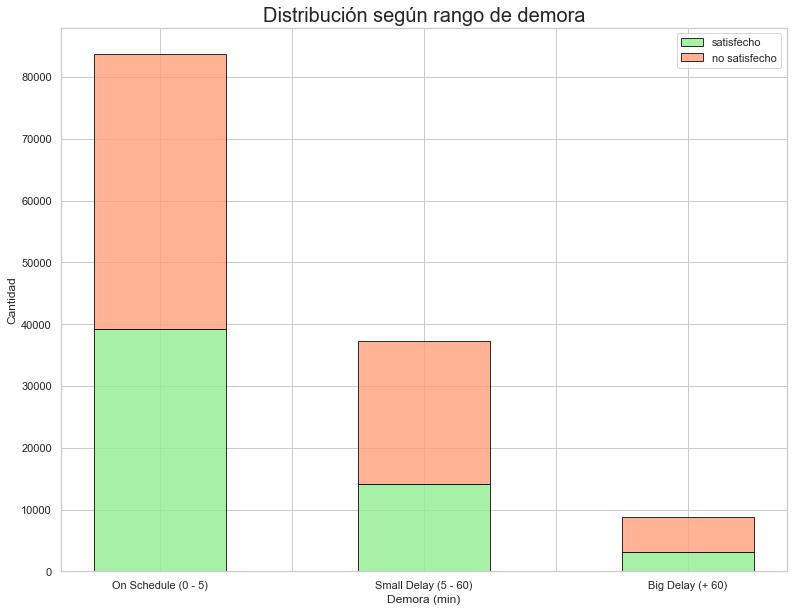

In [44]:
satisfied = data[data['satisfaction'] == 'satisfied']['Flight Delay']
non_satisfied = data[data['satisfaction'] == 'neutral or dissatisfied']['Flight Delay']

sns.set(rc = {'figure.figsize':(13, 10)}, style = "whitegrid")
n, bins, patches = plt.hist([satisfied, non_satisfied], stacked = True, align = 'left', bins = 5, color = {'lightgreen', 'lightsalmon'}, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Demora (min)')
plt.ylabel('Cantidad')
plt.xticks(bins, labels = ['On Schedule (0 - 5)', ' ', 'Small Delay (5 - 60)', ' ', 'Big Delay (+ 60)', ' '])
plt.title('Distribución según rango de demora', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

###


### Atributo 'Age': rangos

In [45]:
def AgeToRange(x):
    if(x <= 20):
        return 0;
    elif(20 < x <= 40):
        return 1;
    elif(40 < x <= 60):
        return 2;
    else:
        return 3;
    
data['Age'] = data['Age'].apply(AgeToRange)
data['Age'].value_counts()

1    53214
2    52554
0    14058
3    10054
Name: Age, dtype: int64

[]

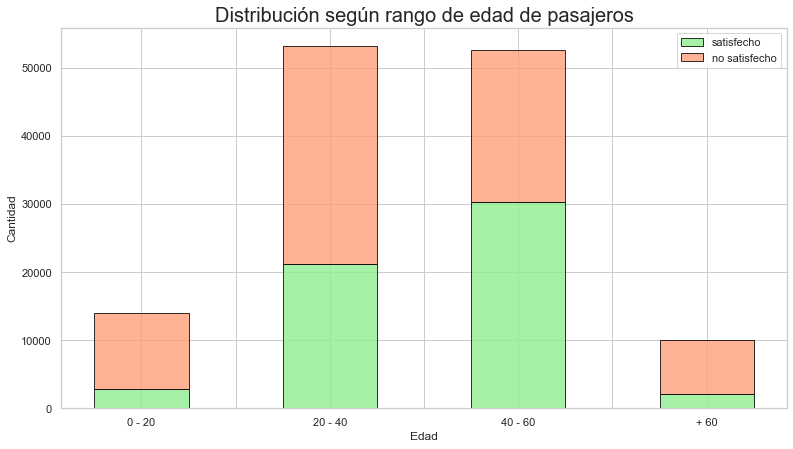

In [46]:
satisfied = data[['Age', 'satisfaction']][data['satisfaction'] == 'satisfied']['Age']
non_satisfied = data[['Age', 'satisfaction']][data['satisfaction'] == 'neutral or dissatisfied']['Age']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
n, bins, patches = plt.hist([satisfied, non_satisfied], stacked = True, align = 'left', bins = 7, color = {'lightgreen', 'lightsalmon'}, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Edad')
plt.ylabel('Cantidad')
plt.xticks(bins, labels = ['0 - 20', ' ', '20 - 40', ' ', '40 - 60', ' ', '+ 60', ' '])
plt.title('Distribución según rango de edad de pasajeros', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

###


### Atributo 'Flight Distance': rangos

In [47]:
def FlightDistanceToRange(x):
    if(x <= 1000):
        return 0;
    elif(1000 < x <= 2750):
        return 1;
    elif(2750 < x):
        return 2;
    
data['Flight Distance'] = data['Flight Distance'].apply(FlightDistanceToRange)
data['Flight Distance'].value_counts()

0    75103
1    41778
2    12999
Name: Flight Distance, dtype: int64

[]

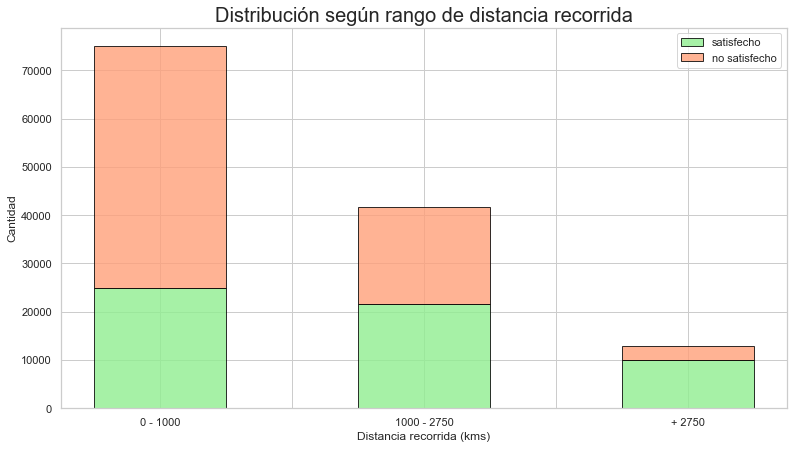

In [48]:
satisfied = data[['Flight Distance', 'satisfaction']][data['satisfaction'] == 'satisfied']['Flight Distance']
non_satisfied = data[['Flight Distance', 'satisfaction']][data['satisfaction'] == 'neutral or dissatisfied']['Flight Distance']

sns.set(rc = {'figure.figsize':(13, 7)}, style = "whitegrid")
n, bins, patches = plt.hist([satisfied, non_satisfied], stacked = True, align = 'left', bins = 5, color = {'lightgreen', 'lightsalmon'}, alpha = 0.8, edgecolor = 'black', label = ['satisfecho', 'no satisfecho'])
plt.xlabel('Distancia recorrida (kms)')
plt.ylabel('Cantidad')
plt.xticks(bins, labels = ['0 - 1000', ' ', '1000 - 2750', ' ', '+ 2750', ' '])
plt.title('Distribución según rango de distancia recorrida', fontdict = {'fontsize': '20'})
plt.legend()
plt.plot()

###



### Atributo 'Gender': balance
- El atributo 'Gender' está balanceado para ambas clases, y su correlación con la satisfacción general (clase/target) es prácticamente nula. Esto nos indica que la ganancia de información será prácticamente 0, y por lo tanto procedemos a dar de baja dicho atributo del dataset.

In [49]:
data.drop(columns = ['Gender'], inplace = True)

###



### Derivación de atributos con alta correlación

In [50]:
data

,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,...,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,satisfaction,Flight Delay
0,Loyal Customer,0,Personal Travel,Eco Plus,0,3,4,3,1,5,...,5,5,4,3,4,4,5,5,neutral or dissatisfied,1
1,disloyal Customer,1,Business travel,Business,0,3,2,3,3,1,...,1,1,1,5,3,1,4,1,neutral or dissatisfied,0
2,Loyal Customer,1,Business travel,Business,1,2,2,2,2,5,...,5,5,4,3,4,4,4,5,satisfied,0
3,Loyal Customer,1,Business travel,Business,0,2,5,5,5,2,...,2,2,2,5,3,1,4,2,neutral or dissatisfied,1
4,Loyal Customer,3,Business travel,Business,0,3,3,3,3,4,...,5,3,3,4,4,3,3,3,satisfied,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129875,disloyal Customer,1,Business travel,Business,0,3,3,3,1,4,...,4,4,3,2,4,4,5,4,neutral or dissatisfied,0
129876,Loyal Customer,1,Business travel,Business,0,4,4,4,4,4,...,4,4,4,5,5,5,5,4,satisfied,0
129877,Loyal Customer,0,Personal Travel,Eco,0,2,5,1,5,2,...,2,2,4,3,4,5,4,2,neutral or dissatisfied,0
129878,Loyal Customer,0,Business travel,Business,1,3,3,3,3,4,...,4,4,3,2,5,4,5,4,satisfied,0


In [51]:
data['Online Services'] = ((data['Ease of Online booking'] + data['Online boarding'] + data['Inflight wifi service']) / 3).round().astype('int64')
data.drop(columns = ['Ease of Online booking', 'Online boarding', 'Inflight wifi service'], inplace = True)

In [52]:
# data['Online Services'] = ((data['Ease of Online booking'] + data['Online boarding']) / 2).round().astype('int64')
# data.drop(columns = ['Ease of Online booking', 'Online boarding'], inplace = True)

In [54]:
data['Cabin comfort'] = ((data['Inflight entertainment'] + data['Seat comfort'] + data['Cleanliness']) / 3).round().astype('int64')
data.drop(columns = ['Inflight entertainment', 'Seat comfort', 'Cleanliness'], inplace = True)

In [55]:
# data['Seat comfort'] = ((data['Leg room service'] + data['Seat comfort']) / 2).round().astype('int64')
# data.drop(columns = ['Leg room service'], inplace = True)

In [56]:
data.head(1).T

,0
Customer Type,Loyal Customer
Age,0
Type of Travel,Personal Travel
Class,Eco Plus
Flight Distance,0
Departure/Arrival time convenient,4
Gate location,1
Food and drink,5
On-board service,4
Leg room service,3


##


## Guardado de dataset final

In [57]:
data.to_csv('data/data_final.csv', index = False)